In [1127]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.decomposition import FastICA
from sklearn.random_projection import GaussianRandomProjection
from sklearn.manifold import TSNE
from sklearn.metrics import mean_squared_error
from sklearn.metrics import recall_score
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import RandomForestClassifier

from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

import time

from sklearn.metrics import silhouette_score
from sklearn.metrics import classification_report
from yellowbrick.cluster import KElbowVisualizer

from sklearn.manifold import TSNE

from sklearn.model_selection import validation_curve, learning_curve
from sklearn.model_selection import GridSearchCV

import warnings
warnings.filterwarnings("ignore")
%matplotlib inline


In [1128]:
dataset = 'Cancer'

In [1129]:
df = pd.read_csv('../data/data.csv', sep=',')

In [1130]:
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [1131]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [1132]:
df.isnull().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [1133]:
df.drop(df.columns[-1], axis=1, inplace=True)
df.drop('id', axis=1, inplace=True)

In [1134]:
df['diagnosis'].value_counts()

B    357
M    212
Name: diagnosis, dtype: int64

In [1135]:
label = 'diagnosis'
df[label] = df[label].map({'M':1, 'B':0})

In [1136]:
df[label].value_counts()

0    357
1    212
Name: diagnosis, dtype: int64

In [1137]:
X_train, X_test, y_train, y_test = train_test_split(df.drop(label, axis=1), 
                                                    df.loc[:,label], 
                                                    test_size=0.2, 
                                                    random_state=123,
                                                    stratify=df.loc[:,label])

In [1138]:
scaler = StandardScaler()
scaler.fit(X_train)
X_train = pd.DataFrame(scaler.transform(X_train), 
                 columns=X_train.columns, 
                 index=X_train.index)

X_test = pd.DataFrame(scaler.transform(X_test), 
                 columns=X_test.columns, 
                 index=X_test.index)

# Step 1: K-Means and EM without DR

In [1139]:
# plt.clf()
# plt.figure(figsize=(10, 6))
# model = KMeans(init='k-means++', random_state=123)
# visualizer = KElbowVisualizer(model, k=(1,10))
# visualizer.fit(X_train)        # Fit the data to the visualizer
# plt.grid()
# #plt.title('Elbow Method {} - {}'.format(model, dataset))
# visualizer.show()


In [1140]:
# for n_clusters in range_n_clusters:
#     clusterer = KMeans(n_clusters=n_clusters)
#     preds = clusterer.fit_predict(df)
#     centers = clusterer.cluster_centers_

#     score = silhouette_score(df, preds)

In [1325]:
wcss = {}
silhoutte = {}
for k in range(2, 10):
    kmeans = KMeans(n_clusters = k, init = 'k-means++', random_state=123).fit(X_train)
    pred = kmeans.predict(X_train)
    silhoutte[k] = silhouette_score(X_train, pred)
    wcss[k] = kmeans.inertia_
    

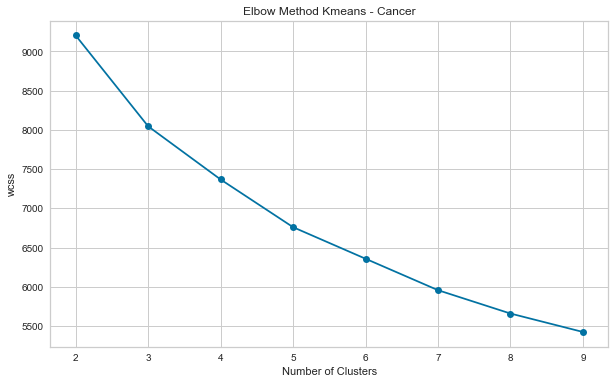

In [1326]:
model = 'Kmeans'
plt.figure(figsize=(10,6))
plt.plot(list(wcss.keys()), list(wcss.values()), marker='o')

plt.title('Elbow Method {} - {}'.format(model, dataset))
plt.xlabel('Number of Clusters')
plt.ylabel("wcss")
plt.grid(True)
plt.show()

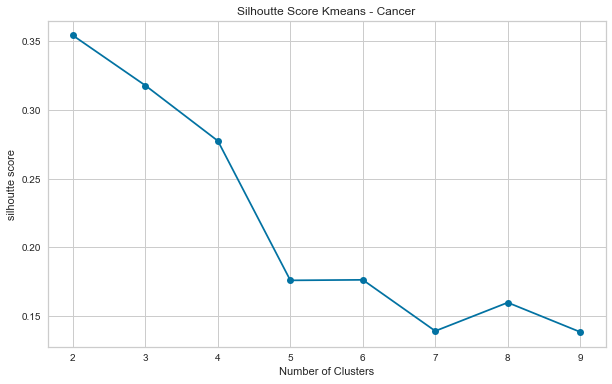

In [1327]:
model = 'Kmeans'
plt.figure(figsize=(10,6))
plt.plot(list(silhoutte.keys()), list(silhoutte.values()), marker='o')

plt.title('Silhoutte Score {} - {}'.format(model, dataset))
plt.xlabel('Number of Clusters')
plt.ylabel("silhoutte score")
plt.grid(True)
plt.show()

In [1328]:
# will pick K = 4 for K-means algorithm.
k_kmeans = 4
kmeans = KMeans(n_clusters = k_kmeans, init = 'k-means++', random_state=123).fit(X_train)
pred = kmeans.predict(X_train)
X_train['pred_Kmeans_s1'] = pred

In [1329]:
X_train['pred_Kmeans_s1'].value_counts()

1    273
3     93
0     58
2     31
Name: pred_Kmeans_s1, dtype: int64

In [1146]:
X_train.groupby('pred_Kmeans_s1').mean()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
pred_Kmeans_s1,,,,,,,,,,,,,,,,,,,,,
0,-0.435672,0.111893,-0.354753,-0.436519,0.891585,1.052449,0.694303,0.330441,0.828510,1.537590,...,-0.372409,0.181003,-0.280307,-0.386326,0.874209,1.054436,0.909908,0.520353,0.596627,1.438133
1,-0.491085,-0.280845,-0.512233,-0.485729,-0.375881,-0.598794,-0.628321,-0.631081,-0.367466,-0.221920,...,-0.527092,-0.281809,-0.545280,-0.508919,-0.375515,-0.544500,-0.591081,-0.634657,-0.330339,-0.402764
2,2.103150,0.851334,2.186029,2.287925,0.851585,1.980819,2.171495,2.325152,1.022102,0.394672,...,2.170472,0.614145,2.277862,2.333411,0.412175,1.370917,1.434349,1.834504,0.676917,0.562291
3,1.012231,0.470854,0.996220,0.935445,0.263487,0.441110,0.687587,0.871395,0.221285,-0.439042,...,1.056034,0.509646,1.016188,0.957054,0.419721,0.483795,0.689523,0.927004,0.371977,0.097976


In [1147]:
X_train.columns

Index(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst', 'pred_Kmeans_s1'],
      dtype='object')

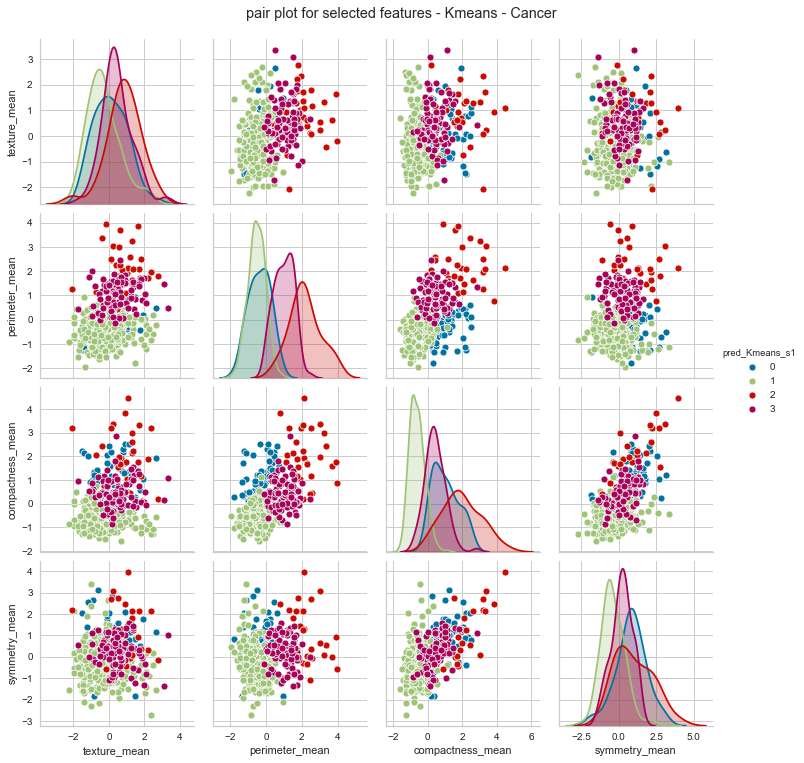

In [1148]:
columns = ['texture_mean', 'perimeter_mean', 'compactness_mean', 'symmetry_mean', 'pred_Kmeans_s1']
sns.pairplot(data=X_train[columns], hue='pred_Kmeans_s1')
plt.suptitle('pair plot for selected features - {} - {}'.format(model, dataset), y=1.04, fontsize='x-large')
plt.show()

In [1331]:
model = 'EM'
silhoutte = {}
BIC = {}
for k in range(2, 10):
    em = GaussianMixture(n_components = k, random_state=123).fit(X_train)
    pred = em.predict(X_train)
    bic = em.bic(X_train)
    silhoutte[k] = silhouette_score(X_train, pred)
    BIC[k] = bic
    


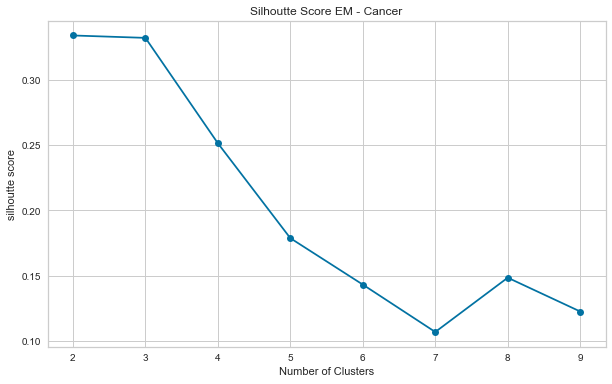

In [1332]:

plt.figure(figsize=(10,6))
plt.plot(list(silhoutte.keys()), list(silhoutte.values()), marker='o')

plt.title('Silhoutte Score {} - {}'.format(model, dataset))
plt.xlabel('Number of Clusters')
plt.ylabel("silhoutte score")
plt.grid(True)
plt.show()

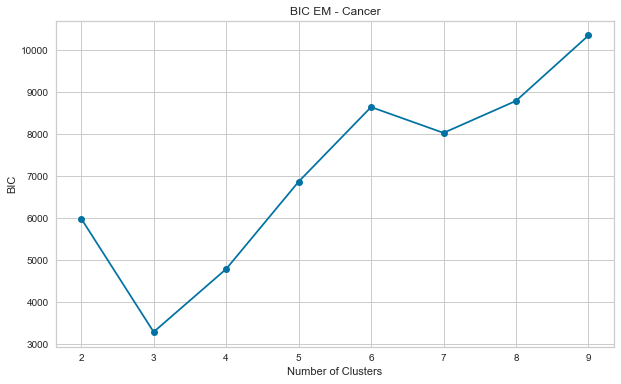

In [1333]:
model = 'EM'
plt.figure(figsize=(10,6))
plt.plot(list(BIC.keys()), list(BIC.values()), marker='o')

plt.title('BIC {} - {}'.format(model, dataset))
plt.xlabel('Number of Clusters')
plt.ylabel("BIC")
plt.grid(True)
plt.show()

In [1334]:
# will pick K = 3 for EM algorithm.
k_em = 3
em = GaussianMixture(n_components = k_em, random_state=123).fit(X_train)
pred = em.predict(X_train)
X_train['pred_EM_s1'] = pred


In [1153]:
X_train['pred_EM_s1'].value_counts()

2    271
1    124
0     60
Name: pred_EM_s1, dtype: int64

In [1154]:
X_train.groupby('pred_EM_s1').mean()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,pred_Kmeans_s1
pred_EM_s1,,,,,,,,,,,,,,,,,,,,,
0,-0.444540,0.091352,-0.365190,-0.444404,0.873259,1.019156,0.657941,0.314442,0.785240,1.492933,...,0.152831,-0.293342,-0.395964,0.832579,1.014538,0.862194,0.496206,0.542804,1.389862,0.033333
1,1.284961,0.565974,1.293672,1.273565,0.410512,0.826037,1.058564,1.234834,0.421489,-0.230613,...,0.535771,1.331607,1.301143,0.417835,0.705575,0.875730,1.153879,0.448212,0.214055,2.750000
2,-0.489530,-0.279195,-0.511085,-0.484346,-0.381177,-0.603609,-0.630031,-0.634635,-0.366712,-0.225018,...,-0.278987,-0.544350,-0.507690,-0.375521,-0.547467,-0.591595,-0.637835,-0.325264,-0.405663,1.000000


In [1155]:
X_train.columns

Index(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst', 'pred_Kmeans_s1',
       'pred_EM_s1'],
      dtype='object')

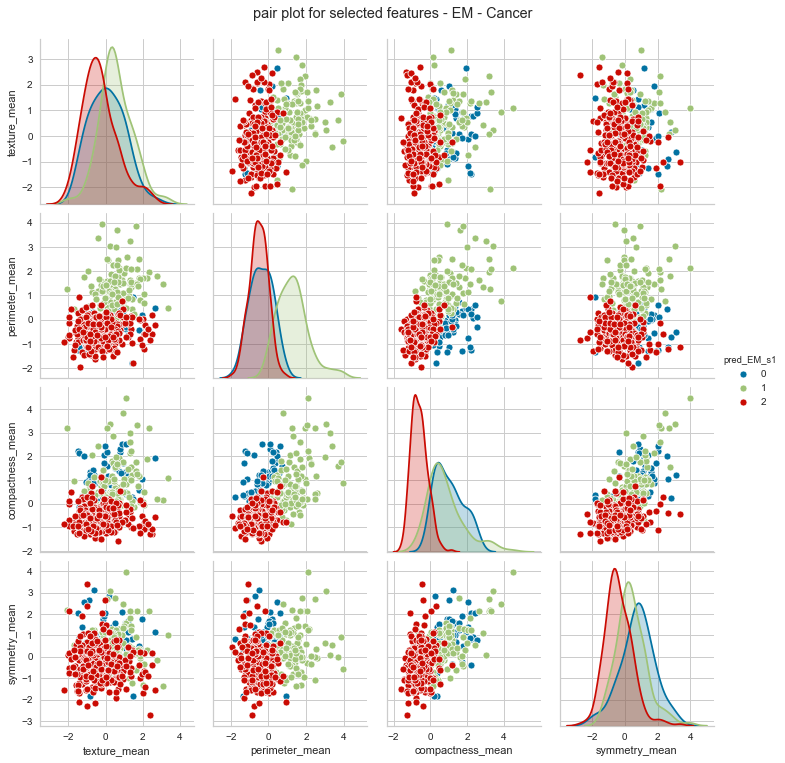

In [1156]:
columns = ['texture_mean', 'perimeter_mean', 'compactness_mean', 'symmetry_mean', 'pred_EM_s1']
sns.pairplot(data=X_train[columns], hue='pred_EM_s1')
plt.suptitle('pair plot for selected features - {} - {}'.format(model, dataset), y=1.04, fontsize='x-large')
plt.show()

In [1335]:
X_train['pred_EM_s1'].value_counts()

2    271
1    124
0     60
Name: pred_EM_s1, dtype: int64

# Step 2 - PCA

In [1158]:
X_train = X_train.iloc[:, :-2]

In [1159]:
pca = PCA()
X_pca = pca.fit(X_train)


In [1160]:
# X_pca.explained_variance_ratio_

In [1161]:
df_pca = pd.DataFrame(X_pca.explained_variance_ratio_, columns=['variance_explained'])
df_pca['c_sum'] = df_pca.cumsum()
df_pca['n_PCs'] = np.array(df_pca.index) + 1
df_pca = df_pca[['n_PCs', 'variance_explained', 'c_sum']]
df_pca

,n_PCs,variance_explained,c_sum
0,1,0.446815,0.446815
1,2,0.185589,0.632404
2,3,0.097282,0.729686
3,4,0.065363,0.795049
4,5,0.053007,0.848056
5,6,0.041007,0.889063
6,7,0.021912,0.910975
7,8,0.015462,0.926437
8,9,0.013918,0.940355
9,10,0.011164,0.951519


In [1162]:
# ax1 = sns.set_style(style=None, rc=None )
# fig, ax1 = plt.subplots(figsize=(12, 8))
# sns.lineplot(data = df_pca['cum_sum'], marker='o', sort = False, ax=ax1)
# ax2 = ax1.twinx()
# sns.barplot(data = df_pca, x=df_pca.index, y='variance_explianed', alpha=0.5, ax=ax2)
# plt.title('Variance Explianed PCA - {}'.format(dataset))
# plt.xlabel('Number of Clusters')
# plt.ylabel('')
# plt.show()

# # plt.figure(figsize=(10,6))
# # xlabel = ['PC{}'.format(i) for i in range(1, 11) ]
# # plt.bar(xlabel, pca.explained_variance_ratio_[:10])
# # plt.plot()

In [1163]:
thres = 0.9
df_pca[df_pca['c_sum'] >= thres].head(2)

,n_PCs,variance_explained,c_sum
6,7,0.021912,0.910975
7,8,0.015462,0.926437


In [1164]:
rc_error = {}
for i in range(2, X_train.shape[1]):
    pca = PCA(n_components=i)
    X_pca = pca.fit_transform(X_train)
    inverse_data = np.linalg.pinv(pca.components_.T)
    reconstructed = np.dot(X_pca, inverse_data)
    rc_err = mean_squared_error(X_train.values, reconstructed)    
    rc_error[i] = rc_err

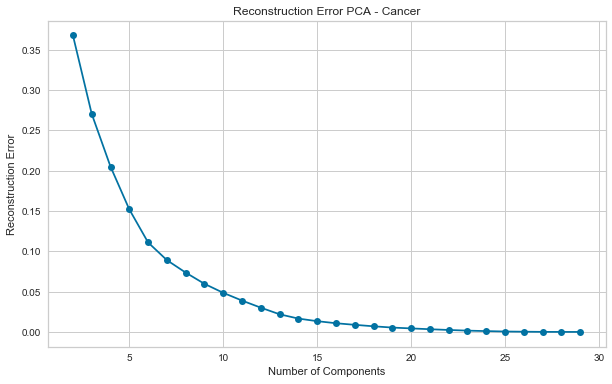

In [1338]:
model = 'PCA'
plt.figure(figsize=(10,6))
plt.plot(list(rc_error.keys()), list(rc_error.values()), marker='o')

plt.title('Reconstruction Error {} - {}'.format(model, dataset))
plt.xlabel('Number of Components')
plt.ylabel("Reconstruction Error")
plt.grid(True)
plt.show()


In [1166]:
n_pca = 7
pca = PCA(n_components = n_pca, random_state=123)
df_pca = pd.DataFrame(pca.fit_transform(X_train), columns=['PC-{}'.format(i+1) for i in range(n_pca)])

In [1167]:
# # df_test = pd.DataFrame(pca.components_[:2].T)
# # sns.scatterplot(data=df_test, x='0', y='1')

# pca = PCA(n_components = 2)
# features_2D = pca.fit_transform(X_train)

# ev1, ev2 = pca.explained_variance_ratio_[:2]
# ax = plt.figure().gca(title='2D Projection for True Values Dimensionality Reduction', 
#                       xlabel='Explained Variance: {:.2%}'.format(ev1), 
#                       ylabel='Explained Variance: {:.2%}'.format(ev2))
# ax.scatter(*features_2D.T, c= y_train.astype(np.float), s=10, cmap = 'viridis');

In [1168]:
# df_tsne

In [1169]:
# tsne = TSNE(learning_rate = 50, perplexity=800, n_iter=1000)
# tsne_features = tsne.fit_transform(df_pca)
# df_tsne = df_pca.copy()
# df_tsne['x'] = tsne_features[:, 0]
# df_tsne['y'] = tsne_features[:, 1]
# sns.scatterplot(x='x', y='y', hue='PC-1', data=df_tsne)


# Step 2 - ICA

In [1191]:
kurt = {}
rc_error = {}
for i in range(2, X_train.shape[1]):
    ica = FastICA(n_components=i, random_state=123)
    X_ica = ica.fit_transform(X_train)
    X_temp = pd.DataFrame(X_ica)
    X_temp = X_temp.kurt(axis=0)
    kurt[i] = X_temp.abs().mean()
    
    inverse_data = np.linalg.pinv(ica.components_.T)
    reconstructed = np.dot(X_ica, inverse_data)
    rc_err = mean_squared_error(X_train.values, reconstructed)    
    rc_error[i] = rc_err

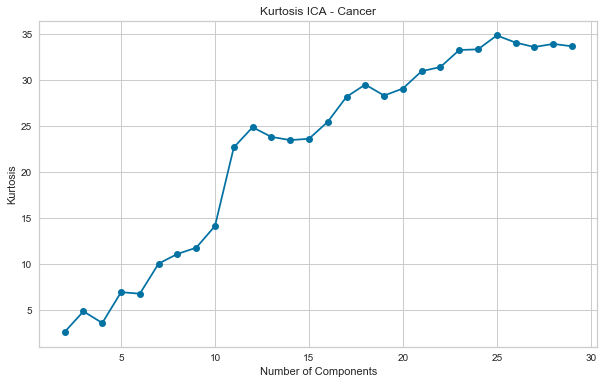

In [1337]:
model = 'ICA'
plt.figure(figsize=(10,6))
plt.plot(list(kurt.keys()), list(kurt.values()), marker='o')

plt.title('Kurtosis {} - {}'.format(model, dataset))
plt.xlabel('Number of Components')
plt.ylabel("Kurtosis")
plt.grid(True)
plt.show()


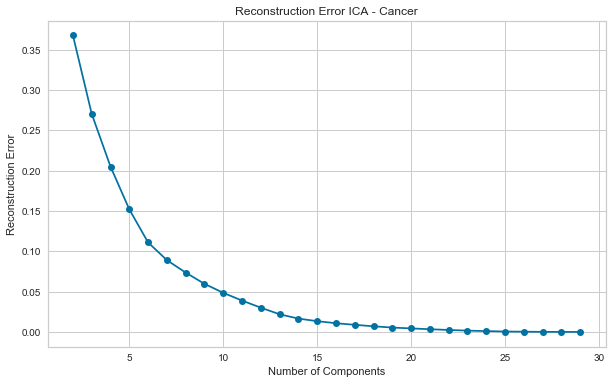

In [1339]:
model = 'ICA'
plt.figure(figsize=(10,6))
plt.plot(list(rc_error.keys()), list(rc_error.values()), marker='o')

plt.title('Reconstruction Error {} - {}'.format(model, dataset))
plt.xlabel('Number of Components')
plt.ylabel("Reconstruction Error")
plt.grid(True)
plt.show()


In [805]:

# ica = FastICA(n_components=3, random_state=123)
# df_ica = ica.fit_transform(X_train)

In [806]:
# plt.figure(figsize=(8,5))
# plt.title('ICA Components')
# plt.scatter(df_ica[:,0], df_ica[:,1])
# plt.scatter(df_ica[:,1], df_ica[:,2])
# plt.scatter(df_ica[:,2], df_ica[:,0])

In [998]:
n_ica = 12

# Step 2 - Randomized Projections

In [854]:
rc_error = {}
for i in range(2, X_train.shape[1]):
    rca = GaussianRandomProjection(n_components=i, random_state=123)
    X_rca = rca.fit_transform(X_train)
    
    inverse_data = np.linalg.pinv(rca.components_.T)
    reconstructed = np.dot(X_rca, inverse_data)
    rc_err = mean_squared_error(X_train.values, reconstructed)    
    rc_error[i] = rc_err
    


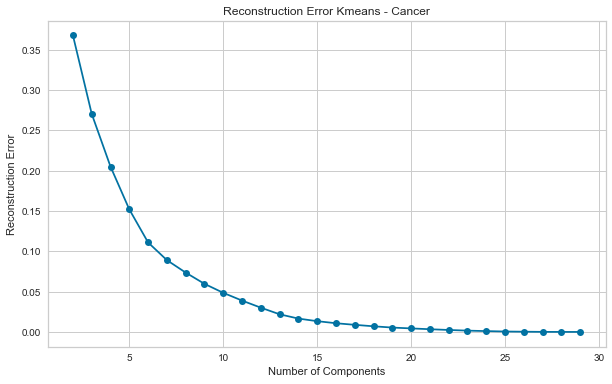

In [1340]:
model = 'Kmeans'
plt.figure(figsize=(10,6))
plt.plot(list(rc_error.keys()), list(rc_error.values()), marker='o')

plt.title('Reconstruction Error {} - {}'.format(model, dataset))
plt.xlabel('Number of Components')
plt.ylabel("Reconstruction Error")
plt.grid(True)
plt.show()


In [1341]:
# ra = GaussianRandomProjection(n_components=12, random_state=123)
# df_ra = ra.fit_transform(X_train)
n_rp = 12

# Step 2 - additional feature selection method

In [857]:
rf = RandomForestClassifier()
rf.fit(X_train, y_train)


RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

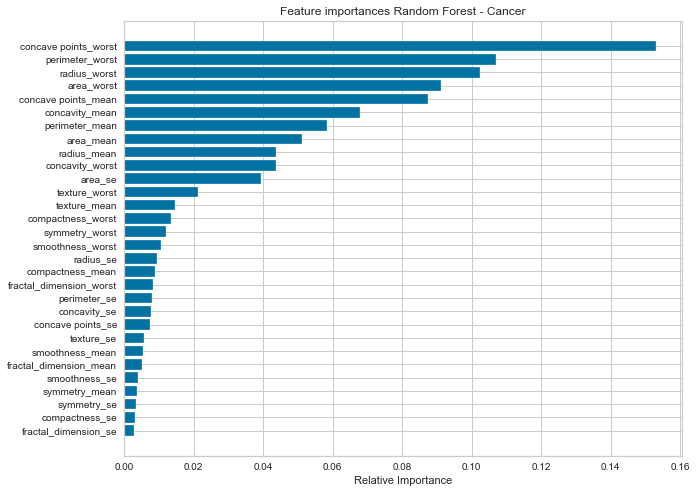

In [859]:
model = 'Random Forest'
importances = rf.feature_importances_
features = X_train.columns
indices = np.argsort(importances)

plt.figure(figsize=(10, 8))
plt.title('Feature importances {} - {}'.format(model, dataset))
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), features[indices])
plt.xlabel('Relative Importance')
plt.show()

In [860]:
thres = 0.9
df_fi = pd.DataFrame(importances, index=features, columns = ['importance'])
df_fi.sort_values(by='importance', ascending=False, inplace=True)
df_fi['c_sum'] = df_fi.cumsum()
rf_columns = df_fi[df_fi['c_sum'] < thres].index


In [861]:
print(rf_columns)
print(len(rf_columns))

Index(['concave points_worst', 'perimeter_worst', 'radius_worst', 'area_worst',
       'concave points_mean', 'concavity_mean', 'perimeter_mean', 'area_mean',
       'radius_mean', 'concavity_worst', 'area_se', 'texture_worst',
       'texture_mean', 'compactness_worst'],
      dtype='object')
14


# Step 3 - reproduce cluster on reduced dimension

## K-means with PCA, ICA, RP, xxx

In [1231]:
pca = PCA(n_components = n_pca, random_state=123).fit(X_train)
df_pca = pd.DataFrame(pca.transform(X_train), columns=['PC-{}'.format(i+1) for i in range(n_pca)])
df_pca_test = pd.DataFrame(pca.transform(X_test), columns=['PC-{}'.format(i+1) for i in range(n_pca)])

ica = FastICA(n_components = n_ica, tol=1, random_state=123).fit(X_train)
df_ica = pd.DataFrame(ica.transform(X_train), columns=['Component-{}'.format(i+1) for i in range(n_ica)])
df_ica_test = pd.DataFrame(ica.transform(X_test), columns=['Component-{}'.format(i+1) for i in range(n_ica)])

rp = GaussianRandomProjection(n_components = n_rp, random_state=123).fit(X_train)
df_rp = pd.DataFrame(rp.transform(X_train), columns=['Component-{}'.format(i+1) for i in range(n_rp)])
df_rp_test = pd.DataFrame(rp.transform(X_test), columns=['Component-{}'.format(i+1) for i in range(n_rp)])


df_rf = X_train[rf_columns]
df_rf_test = X_test[rf_columns]
# k_kmeans, k_em

In [1233]:
# pca = PCA(n_components = n_pca, random_state=123)
# df_pca = pd.DataFrame(pca.fit_transform(X_train), columns=['PC-{}'.format(i+1) for i in range(n_pca)])
# df_pca_test = pd.DataFrame(pca.fit_transform(X_test), columns=['PC-{}'.format(i+1) for i in range(n_pca)])

# ica = FastICA(n_components = n_ica, tol=1, random_state=123)
# df_ica = pd.DataFrame(ica.fit_transform(X_train), columns=['Component-{}'.format(i+1) for i in range(n_ica)])
# df_rp_test = pd.DataFrame(ica.fit_transform(X_test), columns=['Component-{}'.format(i+1) for i in range(n_ica)])

# rp = GaussianRandomProjection(n_components = n_rp, random_state=123)
# df_rp = pd.DataFrame(rp.fit_transform(X_train), columns=['Component-{}'.format(i+1) for i in range(n_rp)])
# df_rp_test = pd.DataFrame(rp.fit_transform(X_test), columns=['Component-{}'.format(i+1) for i in range(n_rp)])


# df_rf = X_train[rf_columns]
# df_rf_test = X_test[rf_columns]
# # k_kmeans, k_em

In [1234]:
kmeans_pca = KMeans(n_clusters = k_kmeans, init = 'k-means++', random_state=123).fit(df_pca)
pred_pca = kmeans_pca.predict(df_pca)

kmeans_ica = KMeans(n_clusters = k_kmeans, init = 'k-means++', random_state=123).fit(df_ica)
pred_ica = kmeans_ica.predict(df_ica)

kmeans_rp = KMeans(n_clusters = k_kmeans, init = 'k-means++', random_state=123).fit(df_rp)
pred_rp = kmeans_rp.predict(df_rp)

kmeans_rf = KMeans(n_clusters = k_kmeans, init = 'k-means++', random_state=123).fit(df_rf)
pred_rf = kmeans_rf.predict(df_rf)

df_pca['pred_kmeans'] = pred_pca
df_ica['pred_kmeans'] = pred_ica
df_rp['pred_kmeans'] = pred_rp
df_rf['pred_kmeans'] = pred_rf

df_pca_test['pred_kmeans'] = kmeans_pca.predict(df_pca_test)
# df_ica, df_ica_test, y_ica, y_ica_test = train_test_split(df_ica, pred_ica, test_size=0.2, random_state=123)

In [865]:
# from mpl_toolkits.mplot3d import Axes3D
# fig = plt.figure(1, figsize=(8, 6))
# plt.clf()
# ax = Axes3D(fig, rect=[0, 0, .95, 1], elev=48, azim=134)

# plt.cla()
# ax.set_xlabel('Component 1')
# ax.set_ylabel('Component 2')
# ax.set_zlabel('Component 3')

# ax.scatter(df_pca['PC-1'], df_pca['PC-2'], df_pca['PC-3'], c= pred_pca.astype(np.float), cmap = 'viridis')
# plt.title("3-D K-Means with PCA Dimensionality Reduction", loc = "left")
# #plt.legend()

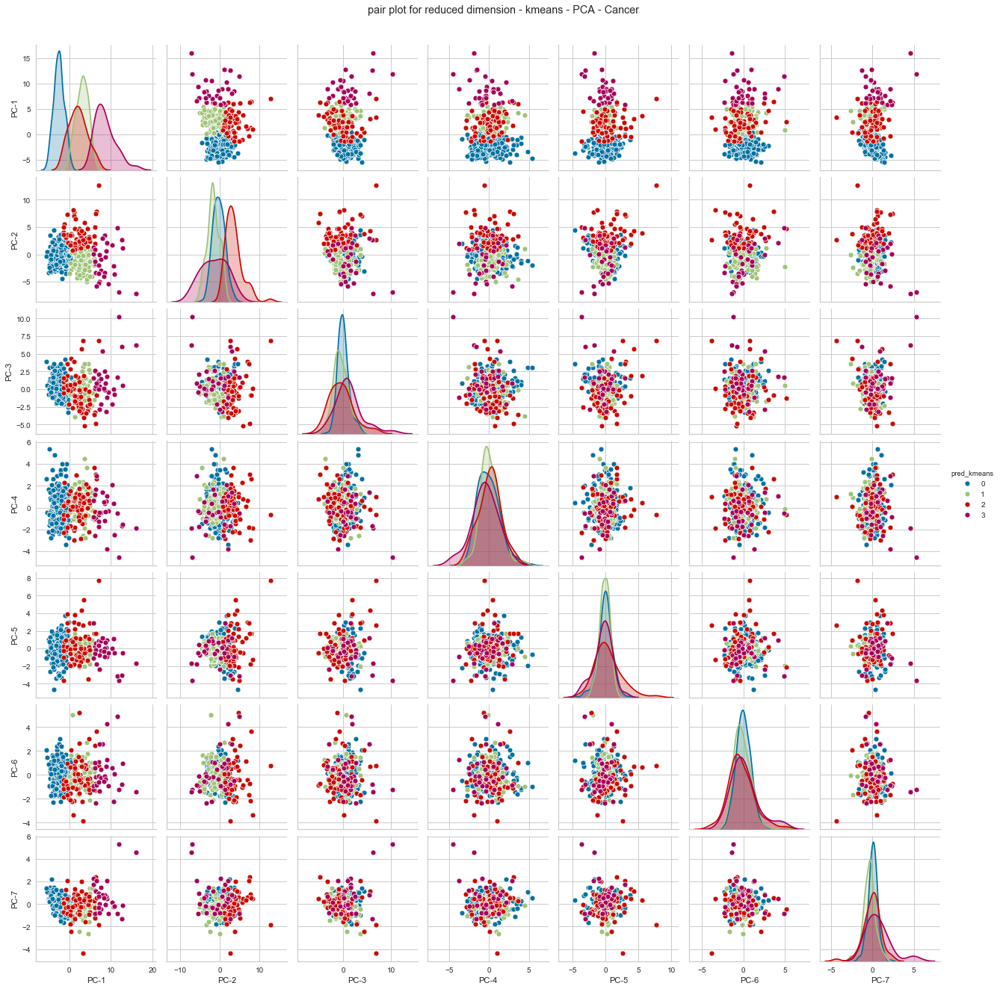

In [875]:
model = 'kmeans'
model2 = 'PCA'
sns.pairplot(data=df_pca, hue='pred_kmeans')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

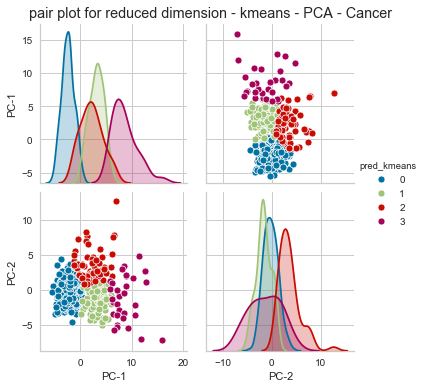

In [876]:
columns = ['PC-1', 'PC-2', 'pred_kmeans']
sns.pairplot(data=df_pca[columns], hue='pred_kmeans')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

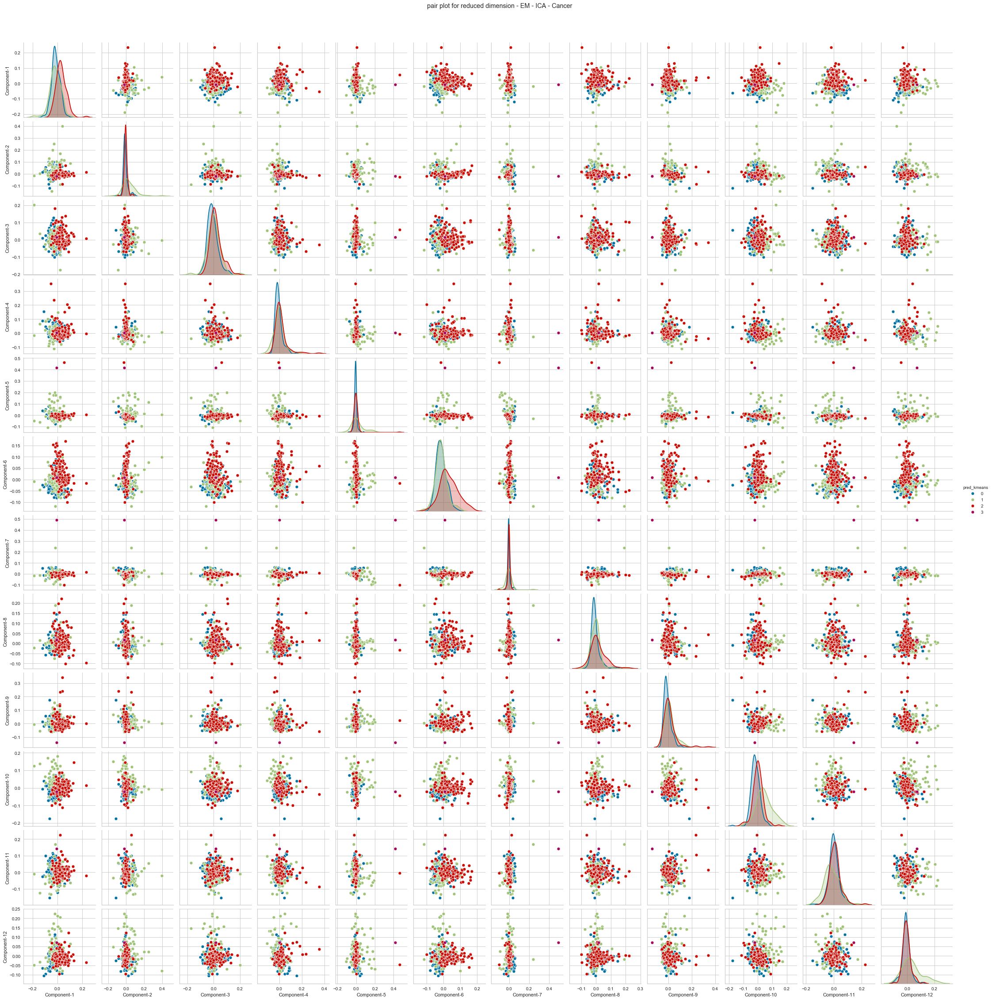

In [1003]:
model2 = 'ICA'
sns.pairplot(data=df_ica, hue='pred_kmeans')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

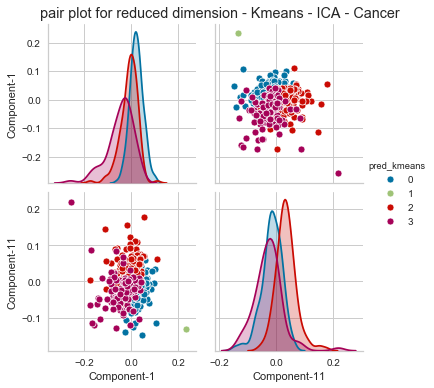

In [1349]:

model2 = 'ICA'
columns = ['Component-1', 'Component-11', 'pred_kmeans']
sns.pairplot(data=df_ica[columns], hue='pred_kmeans')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

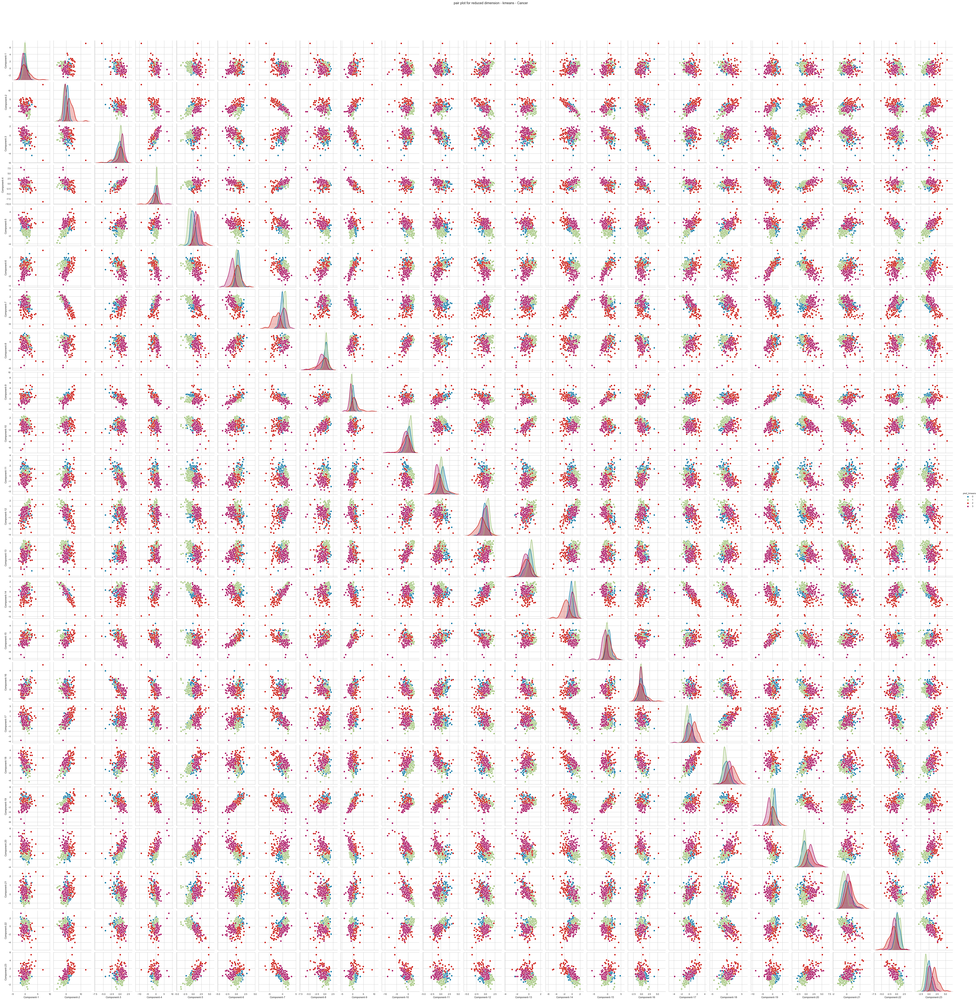

In [870]:
model2 = 'RP'
sns.pairplot(data=df_rp, hue='pred_kmeans')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

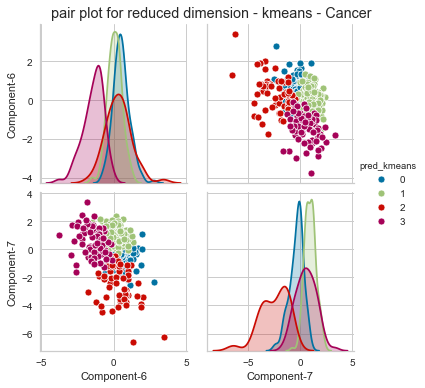

In [871]:
columns = ['Component-6', 'Component-7', 'pred_kmeans']
sns.pairplot(data=df_rp[columns], hue='pred_kmeans')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

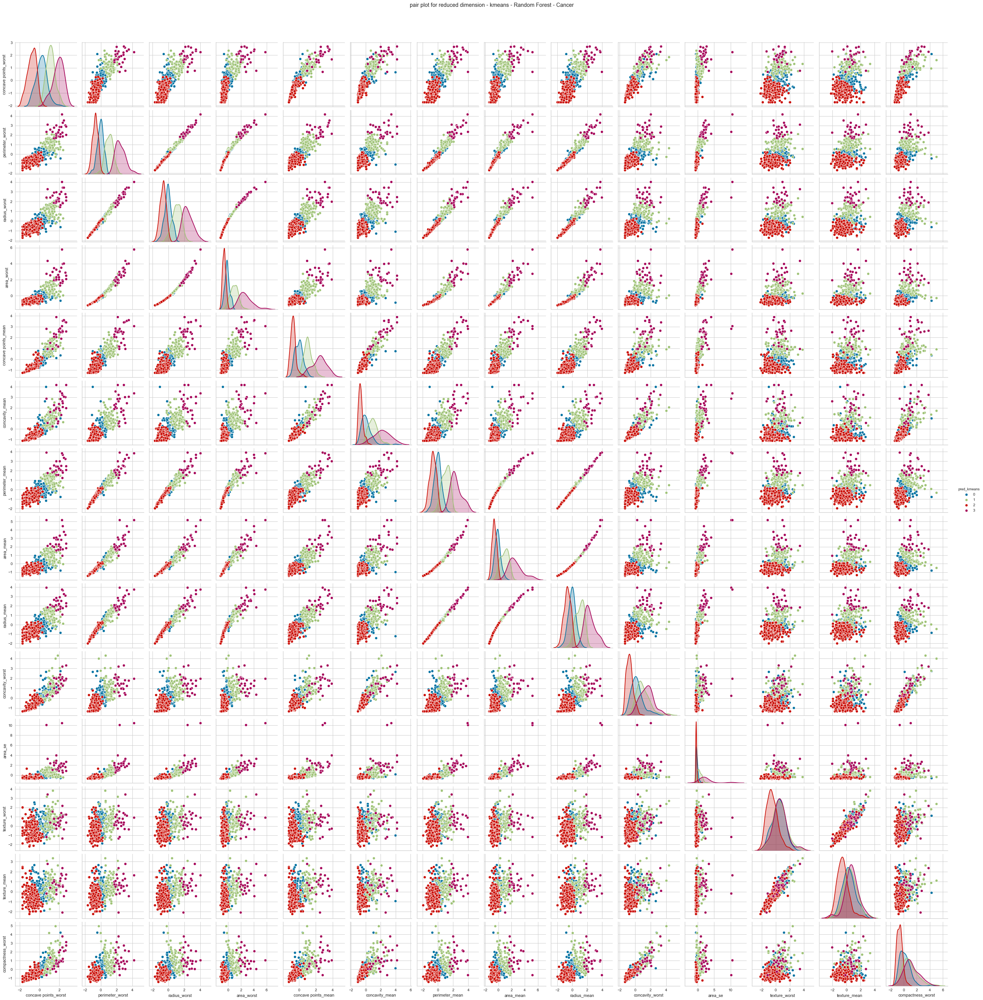

In [877]:
model2 = 'Random Forest'
sns.pairplot(data=df_rf, hue='pred_kmeans')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()


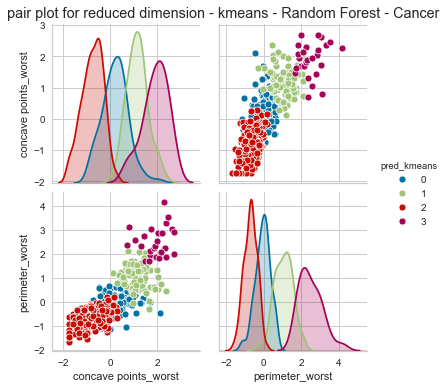

In [888]:
columns = ['concave points_worst', 'perimeter_worst', 'pred_kmeans']
sns.pairplot(data=df_rf[columns], hue='pred_kmeans')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

In [1246]:
em_pca = GaussianMixture(n_components = k_em, random_state=123).fit(df_pca)
pred_pca = em_pca.predict(df_pca)

em_ica = GaussianMixture(n_components = k_em, random_state=123).fit(df_ica)
pred_ica = em_ica.predict(df_ica)

em_rp = GaussianMixture(n_components = k_em, random_state=123).fit(df_rp)
pred_rp = em_rp.predict(df_rp)

em_rf = GaussianMixture(n_components = k_em, random_state=123).fit(df_rf)
pred_rf = em_rf.predict(df_rf)

df_pca['pred_em'] = pred_pca
df_ica['pred_em'] = pred_ica
df_rp['pred_em'] = pred_rp
df_rf['pred_em'] = pred_rf

df_pca_test['pred_em'] = em_pca.predict(df_pca_test)


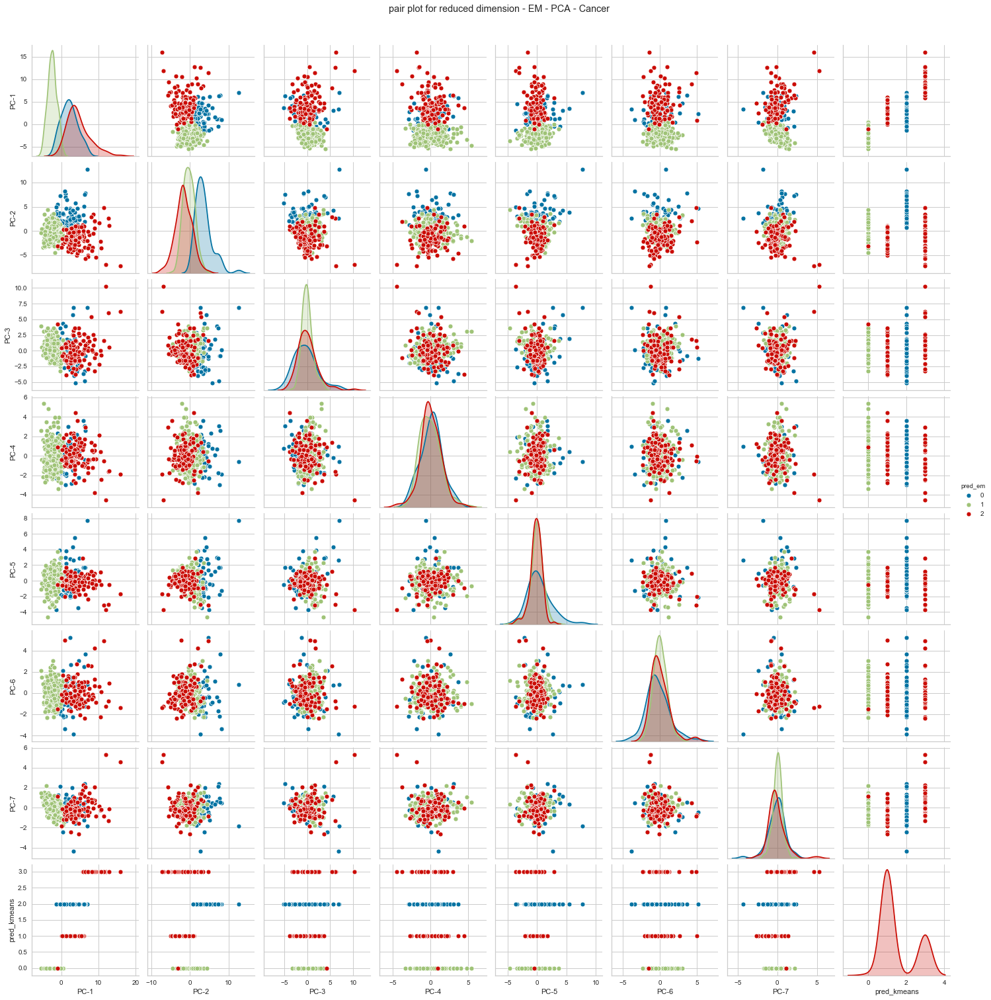

In [1006]:
model = 'EM'
model2 = 'PCA'
sns.pairplot(data=df_pca, hue='pred_em')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

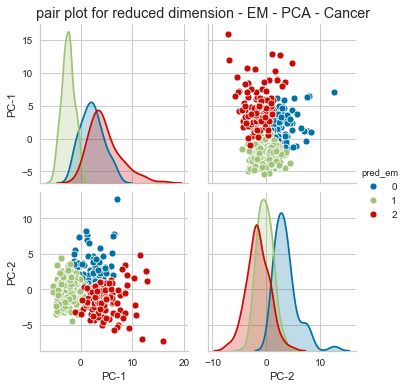

In [891]:
columns = ['PC-1', 'PC-2', 'pred_em']
sns.pairplot(data=df_pca[columns], hue='pred_em')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

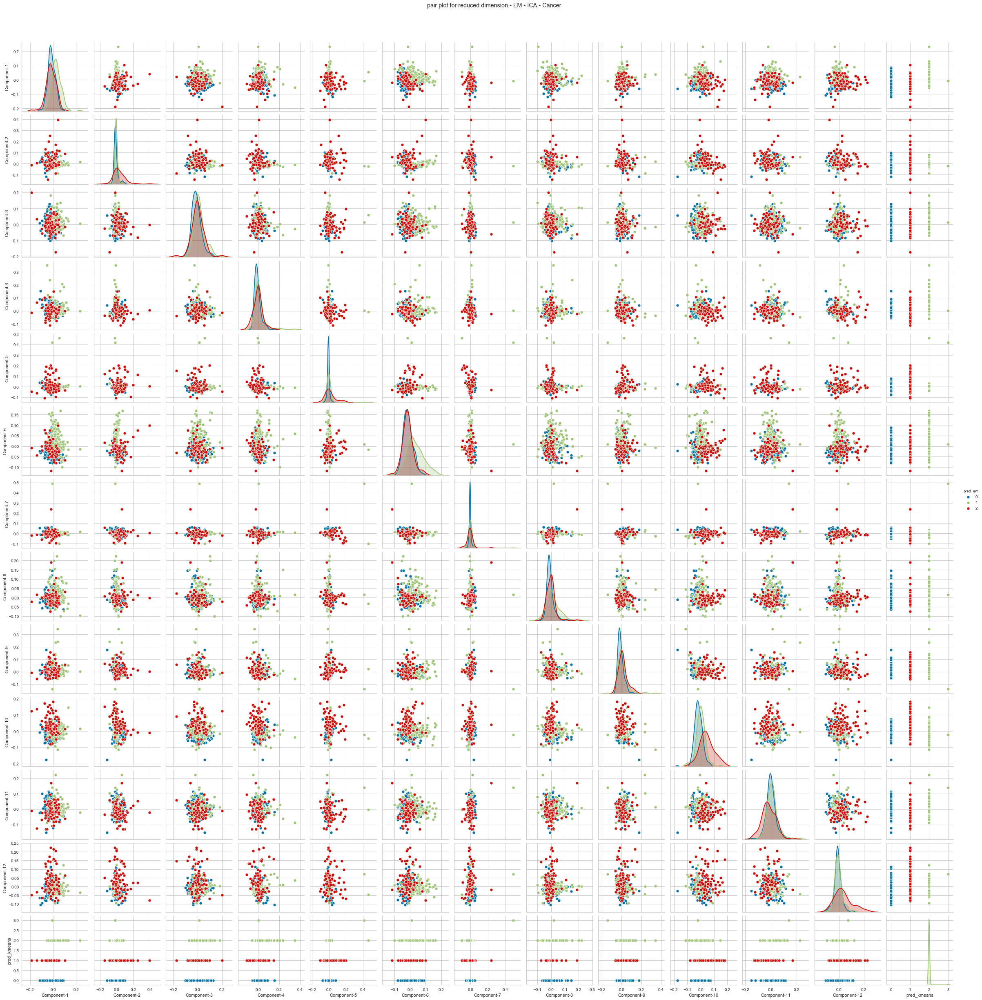

In [1007]:
model2 = 'ICA'
sns.pairplot(data=df_ica, hue='pred_em')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

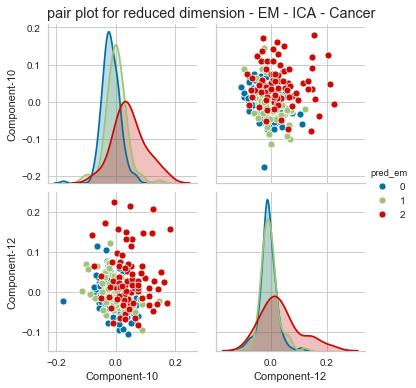

In [1008]:
columns = ['Component-10', 'Component-12', 'pred_em']
sns.pairplot(data=df_ica[columns], hue='pred_em')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

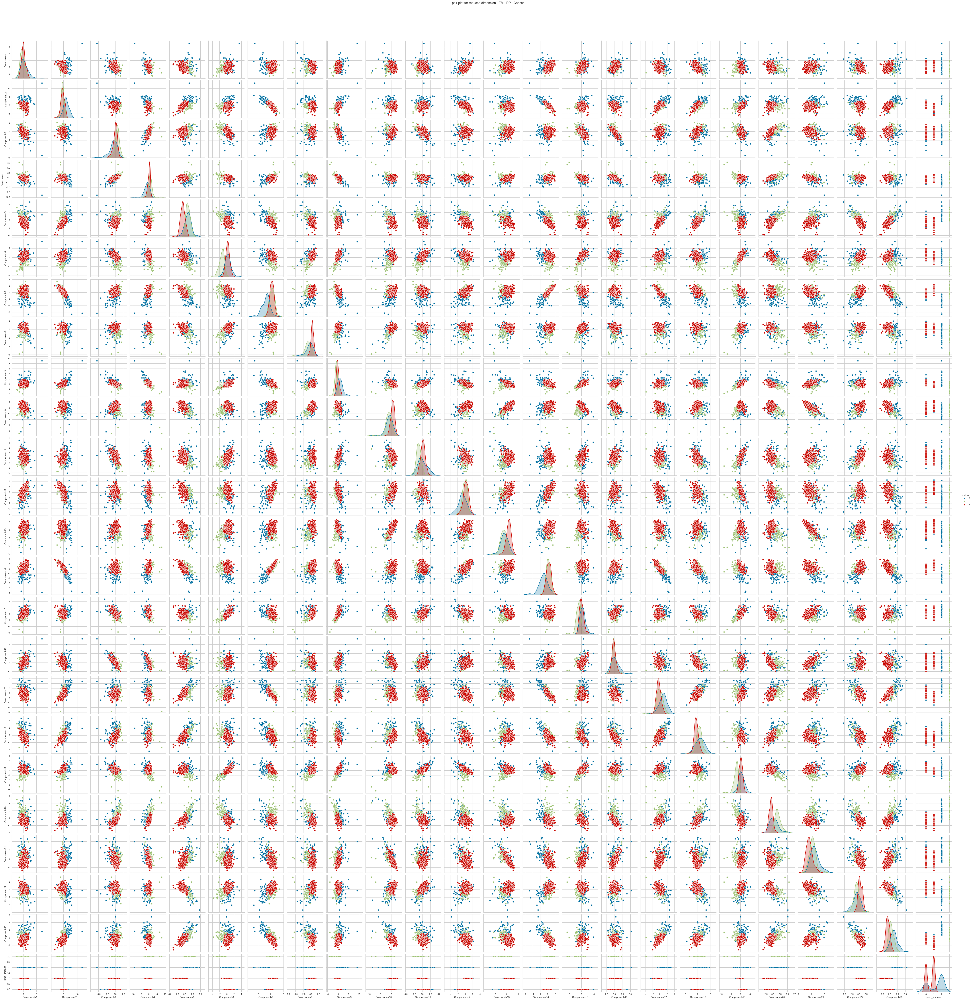

In [894]:
model2 = 'RP'
sns.pairplot(data=df_rp, hue='pred_em')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

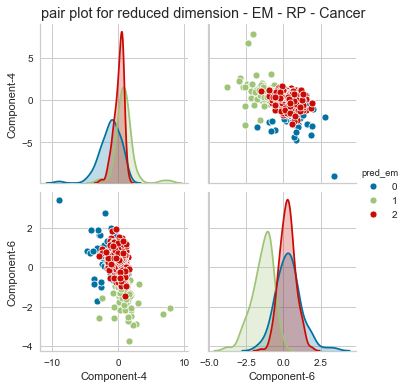

In [895]:
columns = ['Component-4', 'Component-6', 'pred_em']
sns.pairplot(data=df_rp[columns], hue='pred_em')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

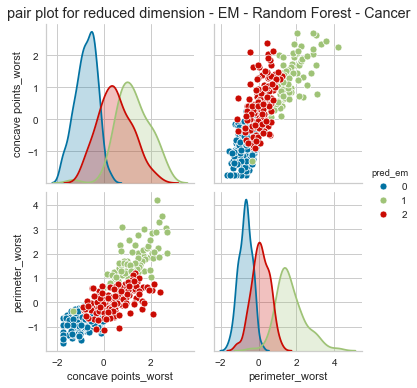

In [897]:
model2 = 'Random Forest'
columns = ['concave points_worst', 'perimeter_worst', 'pred_em']
sns.pairplot(data=df_rf[columns], hue='pred_em')
plt.suptitle('pair plot for reduced dimension - {} - {} - {}'.format(model, model2, dataset), y=1.04, fontsize='x-large')
plt.show()

# Step 4 - Neural Network and Dimension Reduction

In [1198]:
time_dict = {}
recall_dict = {}

In [1199]:

mlp = MLPClassifier()
t_start = time.time()
mlp.fit(X_train, y_train)
t_end = time.time()
time_dict['original'] = round(t_end - t_start, 4)
pred = mlp.predict(X_test)
recall_dict['original'] = round(recall_score(y_test, pred), 4)
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       0.99      0.93      0.96        72
           1       0.89      0.98      0.93        42

    accuracy                           0.95       114
   macro avg       0.94      0.95      0.94       114
weighted avg       0.95      0.95      0.95       114



In [1200]:
# t_start = time.time()
# mlp.fit(df_ica.iloc[:,:-2], y_train)
# t_end = time.time()
# time_dict['ICA'] = round(t_end - t_start, 4)

In [1201]:
mlp = MLPClassifier()

t_start = time.time()
mlp.fit(df_pca.iloc[:,:-2], y_train)
t_end = time.time()
time_dict['PCA'] = round(t_end - t_start, 4)

t_start = time.time()
mlp.fit(df_ica.iloc[:,:-2], y_train)
t_end = time.time()
time_dict['ICA'] = round(t_end - t_start, 4)

t_start = time.time()
mlp.fit(df_rp.iloc[:,:-2], y_train)
t_end = time.time()
time_dict['RP'] = round(t_end - t_start, 4)

t_start = time.time()
mlp.fit(df_rf.iloc[:,:-2], y_train)
t_end = time.time()
time_dict['RF'] = round(t_end - t_start, 4)



In [1202]:
param_dict = {
    'alpha': [0.1, 0.01, 0.001],
    'hidden_layer_sizes': [(30, 30), (50, 50), (100, 100)],
}

grid = GridSearchCV(mlp, 
                    param_grid = param_dict, 
                    cv=5, 
                    verbose=1, 
#                    n_jobs=20,
                    scoring='recall'
                   )
grid.fit(df_pca.iloc[:,:-2], y_train)



Fitting 5 folds for each of 9 candidates, totalling 45 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  45 out of  45 | elapsed:   26.9s finished


GridSearchCV(cv=5, error_score=nan,
             estimator=MLPClassifier(activation='relu', alpha=0.0001,
                                     batch_size='auto', beta_1=0.9,
                                     beta_2=0.999, early_stopping=False,
                                     epsilon=1e-08, hidden_layer_sizes=(100,),
                                     learning_rate='constant',
                                     learning_rate_init=0.001, max_fun=15000,
                                     max_iter=200, momentum=0.9,
                                     n_iter_no_change=10,
                                     nesterovs_momentum=True, power_t=0.5,
                                     random_state=None, shuffle=True,
                                     solver='adam', tol=0.0001,
                                     validation_fraction=0.1, verbose=False,
                                     warm_start=False),
             iid='deprecated', n_jobs=None,
             param_grid=

In [1203]:

print(grid.best_params_)
print(grid.best_score_)
mlp = grid.best_estimator_
alpha = grid.best_params_['alpha']
hidden_layer_sizes = grid.best_params_['hidden_layer_sizes']

{'alpha': 0.001, 'hidden_layer_sizes': (50, 50)}
0.9705882352941178


In [1204]:
t_start = time.time()
pred = mlp.predict(df_pca_test.iloc[:, :-2])
recall_dict['PCA'] = round(recall_score(y_test, pred), 4)
print(classification_report(y_test, pred))


              precision    recall  f1-score   support

           0       0.97      0.94      0.96        72
           1       0.91      0.95      0.93        42

    accuracy                           0.95       114
   macro avg       0.94      0.95      0.94       114
weighted avg       0.95      0.95      0.95       114



In [1223]:
param_dict = {
    'alpha': [0.0001, 0.001, 0.01, 0.1],
    'hidden_layer_sizes': [(100, 100), (300, 300), (500,)],
}

grid = GridSearchCV(mlp, 
                    param_grid = param_dict, 
                    cv=5, 
                    verbose=1, 
#                    n_jobs=20,
                    scoring='recall'
                   )
grid.fit(df_ica.iloc[:, :-2], y_train)



Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  60 out of  60 | elapsed:  1.2min finished


GridSearchCV(cv=5, error_score=nan,
             estimator=MLPClassifier(activation='relu', alpha=0.01,
                                     batch_size='auto', beta_1=0.9,
                                     beta_2=0.999, early_stopping=False,
                                     epsilon=1e-08,
                                     hidden_layer_sizes=(100, 100),
                                     learning_rate='constant',
                                     learning_rate_init=0.001, max_fun=15000,
                                     max_iter=200, momentum=0.9,
                                     n_iter_no_change=10,
                                     nesterovs_momentum=True, power_t=0.5,
                                     random_state=None, shuffle=True,
                                     solver='adam', tol=0.0001,
                                     validation_fraction=0.1, verbose=False,
                                     warm_start=False),
             iid='deprecated'

In [1224]:

print(grid.best_params_)
print(grid.best_score_)
mlp = grid.best_estimator_
alpha = grid.best_params_['alpha']
hidden_layer_sizes = grid.best_params_['hidden_layer_sizes']

{'alpha': 0.0001, 'hidden_layer_sizes': (500,)}
0.9588235294117646


In [ ]:

pred = mlp.predict(df_ica_test.iloc[:, :-1])

recall_dict['ICA'] = round(recall_score(y_test, pred), 4)
print(classification_report(y_test, pred))


In [1240]:
# mlp = MLPClassifier()
# mlp.fit(df_ica.iloc[:,:-2], y_train)

pred = mlp.predict(df_ica_test)

recall_dict['ICA'] = round(recall_score(y_test, pred), 4)
print(classification_report(y_test, pred))


              precision    recall  f1-score   support

           0       0.99      0.94      0.96        72
           1       0.91      0.98      0.94        42

    accuracy                           0.96       114
   macro avg       0.95      0.96      0.95       114
weighted avg       0.96      0.96      0.96       114



In [1209]:
param_dict = {
    'alpha': [0.002, 0.003, 0.005],
    'hidden_layer_sizes': [(30, 30), (50, 50), (100, 100)],
}

grid = GridSearchCV(mlp, 
                    param_grid = param_dict, 
                    cv=5, 
                    verbose=1, 
#                    n_jobs=20,
                    scoring='recall'
                   )
grid.fit(df_rp.iloc[:,:-2], y_train)



Fitting 5 folds for each of 9 candidates, totalling 45 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  45 out of  45 | elapsed:   27.8s finished


GridSearchCV(cv=5, error_score=nan,
             estimator=MLPClassifier(activation='relu', alpha=0.0001,
                                     batch_size='auto', beta_1=0.9,
                                     beta_2=0.999, early_stopping=False,
                                     epsilon=1e-08, hidden_layer_sizes=(500,),
                                     learning_rate='constant',
                                     learning_rate_init=0.001, max_fun=15000,
                                     max_iter=200, momentum=0.9,
                                     n_iter_no_change=10,
                                     nesterovs_momentum=True, power_t=0.5,
                                     random_state=None, shuffle=True,
                                     solver='adam', tol=0.0001,
                                     validation_fraction=0.1, verbose=False,
                                     warm_start=False),
             iid='deprecated', n_jobs=None,
             param_grid=

In [1210]:
print(grid.best_params_)
print(grid.best_score_)
mlp = grid.best_estimator_
alpha = grid.best_params_['alpha']
hidden_layer_sizes = grid.best_params_['hidden_layer_sizes']

{'alpha': 0.005, 'hidden_layer_sizes': (50, 50)}
0.9529411764705882


In [1211]:

pred = mlp.predict(df_rp_test)
recall_dict['RP'] = round(recall_score(y_test, pred), 4)
print(classification_report(y_test, pred))


              precision    recall  f1-score   support

           0       0.97      0.94      0.96        72
           1       0.91      0.95      0.93        42

    accuracy                           0.95       114
   macro avg       0.94      0.95      0.94       114
weighted avg       0.95      0.95      0.95       114



In [1212]:
param_dict = {
    'alpha': [0.01, 0.1, 0.2],
    'hidden_layer_sizes': [(100, 100), (150, 150), (200, 200)],
}

grid = GridSearchCV(mlp, 
                    param_grid = param_dict, 
                    cv=5, 
                    verbose=1, 
#                    n_jobs=20,
                    scoring='recall'
                   )
grid.fit(df_rf.iloc[:, :-2], y_train)



Fitting 5 folds for each of 9 candidates, totalling 45 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  45 out of  45 | elapsed:  1.1min finished


GridSearchCV(cv=5, error_score=nan,
             estimator=MLPClassifier(activation='relu', alpha=0.005,
                                     batch_size='auto', beta_1=0.9,
                                     beta_2=0.999, early_stopping=False,
                                     epsilon=1e-08, hidden_layer_sizes=(50, 50),
                                     learning_rate='constant',
                                     learning_rate_init=0.001, max_fun=15000,
                                     max_iter=200, momentum=0.9,
                                     n_iter_no_change=10,
                                     nesterovs_momentum=True, power_t=0.5,
                                     random_state=None, shuffle=True,
                                     solver='adam', tol=0.0001,
                                     validation_fraction=0.1, verbose=False,
                                     warm_start=False),
             iid='deprecated', n_jobs=None,
             param_grid

In [1213]:
print(grid.best_params_)
print(grid.best_score_)
mlp = grid.best_estimator_
alpha = grid.best_params_['alpha']
hidden_layer_sizes = grid.best_params_['hidden_layer_sizes']

{'alpha': 0.01, 'hidden_layer_sizes': (100, 100)}
0.9647058823529411


In [1214]:
pred = mlp.predict(df_rf_test)
recall_dict['RF'] = round(recall_score(y_test, pred), 4)
print(classification_report(y_test, pred))


              precision    recall  f1-score   support

           0       0.99      0.96      0.97        72
           1       0.93      0.98      0.95        42

    accuracy                           0.96       114
   macro avg       0.96      0.97      0.96       114
weighted avg       0.97      0.96      0.97       114



In [1215]:
time_dict

{'original': 0.5819, 'PCA': 0.4772, 'ICA': 0.4558, 'RP': 0.4684, 'RF': 0.5033}

Text(0.5, 1.0, 'Training time comparison - Breast Cancer Wisconsin')

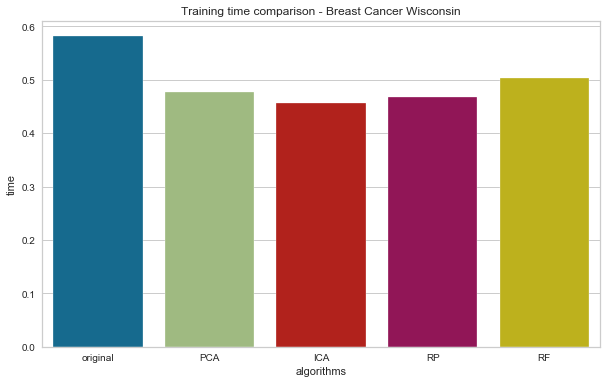

In [1241]:
plt.figure(figsize=(10,6))
df_train_time = pd.DataFrame.from_dict(time_dict, orient='index').reset_index()
df_train_time.columns = ['algorithms', 'time']
ax = sns.barplot(x='algorithms', y='time', data=df_train_time)
plt.title('Training time comparison - Breast Cancer Wisconsin')

Text(0.5, 1.0, 'Recall comparison - Breast Cancer Wisconsin')

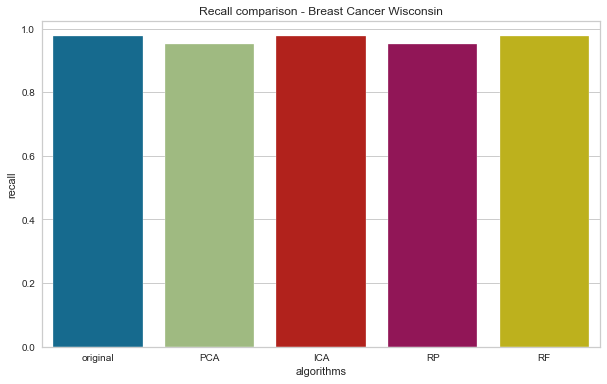

In [1242]:
plt.figure(figsize=(10,6))
df_train_time = pd.DataFrame.from_dict(recall_dict, orient='index').reset_index()
df_train_time.columns = ['algorithms', 'recall']
ax = sns.barplot(x='algorithms', y='recall', data=df_train_time)
plt.title('Recall comparison - Breast Cancer Wisconsin')

# Step 5 - Use cluster as a feature

In [1305]:
df_step5 = df_pca.iloc[:, -2:]
df_step5 = pd.get_dummies(df_step5, columns = df_step5.columns)
df_step5_kmeans = df_step5.iloc[:, :4]
df_step5_em = df_step5.iloc[:, 4:]

df_step5_test = df_pca_test.iloc[:, -2:]
df_step5_test = pd.get_dummies(df_step5_test, columns = df_step5_test.columns)
df_step5_test_kmeans = df_step5_test.iloc[:, :4]
df_step5_test_em = df_step5_test.iloc[:,4:]

In [1306]:
param_dict = {
    'alpha': [0.0001, 0.0005, 0.001, 0.002],
    'hidden_layer_sizes': [(5,5), (10,10), (20, 20)],
}

grid = GridSearchCV(mlp, 
                    param_grid = param_dict, 
                    cv=5, 
                    verbose=1, 
#                    n_jobs=20,
                    scoring='recall'
                   )
grid.fit(df_step5_kmeans, y_train)



Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  60 out of  60 | elapsed:   13.6s finished


GridSearchCV(cv=5, error_score=nan,
             estimator=MLPClassifier(activation='relu', alpha=5e-05,
                                     batch_size='auto', beta_1=0.9,
                                     beta_2=0.999, early_stopping=False,
                                     epsilon=1e-08, hidden_layer_sizes=(10, 10),
                                     learning_rate='constant',
                                     learning_rate_init=0.001, max_fun=15000,
                                     max_iter=200, momentum=0.9,
                                     n_iter_no_change=10,
                                     nesterovs_momentum=True, power_t=0.5,
                                     random_state=None, shuffle=True,
                                     solver='adam', tol=0.0001,
                                     validation_fraction=0.1, verbose=False,
                                     warm_start=False),
             iid='deprecated', n_jobs=None,
             param_grid

In [1307]:
print(grid.best_params_)
print(grid.best_score_)
mlp = grid.best_estimator_
alpha = grid.best_params_['alpha']
hidden_layer_sizes = grid.best_params_['hidden_layer_sizes']

{'alpha': 0.0001, 'hidden_layer_sizes': (10, 10)}
0.8764705882352942


In [1308]:
pred = mlp.predict(df_step5_test_kmeans)
print(classification_report(y_test, pred))


              precision    recall  f1-score   support

           0       0.95      0.86      0.91        72
           1       0.80      0.93      0.86        42

    accuracy                           0.89       114
   macro avg       0.87      0.89      0.88       114
weighted avg       0.90      0.89      0.89       114



In [1309]:
# mlp = MLPClassifier()
# mlp.fit(df_step5, y_train)
# pred = mlp.predict(df_step5_test)
# print(classification_report(y_test, pred))

In [1310]:
param_dict = {
    'alpha': [0.00005, 0.0001, 0.0005, 0.001],
    'hidden_layer_sizes': [(5,5), (10,10), (20, 20), (30, 30)],
}

grid = GridSearchCV(mlp, 
                    param_grid = param_dict, 
                    cv=5, 
                    verbose=1, 
#                    n_jobs=20,
                    scoring='recall'
                   )
grid.fit(df_step5_em, y_train)



Fitting 5 folds for each of 16 candidates, totalling 80 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  80 out of  80 | elapsed:   20.3s finished


GridSearchCV(cv=5, error_score=nan,
             estimator=MLPClassifier(activation='relu', alpha=0.0001,
                                     batch_size='auto', beta_1=0.9,
                                     beta_2=0.999, early_stopping=False,
                                     epsilon=1e-08, hidden_layer_sizes=(10, 10),
                                     learning_rate='constant',
                                     learning_rate_init=0.001, max_fun=15000,
                                     max_iter=200, momentum=0.9,
                                     n_iter_no_change=10,
                                     nesterovs_momentum=True, power_t=0.5,
                                     random_state=None, shuffle=True,
                                     solver='adam', tol=0.0001,
                                     validation_fraction=0.1, verbose=False,
                                     warm_start=False),
             iid='deprecated', n_jobs=None,
             param_gri

In [1311]:
print(grid.best_params_)
print(grid.best_score_)
mlp = grid.best_estimator_
alpha = grid.best_params_['alpha']
hidden_layer_sizes = grid.best_params_['hidden_layer_sizes']

{'alpha': 5e-05, 'hidden_layer_sizes': (10, 10)}
0.8823529411764707


In [1312]:
pred = mlp.predict(df_step5_test_em)
print(classification_report(y_test, pred))


              precision    recall  f1-score   support

           0       0.95      0.86      0.91        72
           1       0.80      0.93      0.86        42

    accuracy                           0.89       114
   macro avg       0.87      0.89      0.88       114
weighted avg       0.90      0.89      0.89       114



In [1313]:
param_dict = {
    'alpha': [0.00005, 0.0001, 0.0005, 0.001],
    'hidden_layer_sizes': [(5,5), (10,10), (20, 20), (30, 30)],
}

grid = GridSearchCV(mlp, 
                    param_grid = param_dict, 
                    cv=5, 
                    verbose=1, 
#                    n_jobs=20,
                    scoring='recall'
                   )
grid.fit(df_step5, y_train)



Fitting 5 folds for each of 16 candidates, totalling 80 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  80 out of  80 | elapsed:   19.4s finished


GridSearchCV(cv=5, error_score=nan,
             estimator=MLPClassifier(activation='relu', alpha=5e-05,
                                     batch_size='auto', beta_1=0.9,
                                     beta_2=0.999, early_stopping=False,
                                     epsilon=1e-08, hidden_layer_sizes=(10, 10),
                                     learning_rate='constant',
                                     learning_rate_init=0.001, max_fun=15000,
                                     max_iter=200, momentum=0.9,
                                     n_iter_no_change=10,
                                     nesterovs_momentum=True, power_t=0.5,
                                     random_state=None, shuffle=True,
                                     solver='adam', tol=0.0001,
                                     validation_fraction=0.1, verbose=False,
                                     warm_start=False),
             iid='deprecated', n_jobs=None,
             param_grid

In [1314]:
print(grid.best_params_)
print(grid.best_score_)
mlp = grid.best_estimator_
alpha = grid.best_params_['alpha']
hidden_layer_sizes = grid.best_params_['hidden_layer_sizes']

{'alpha': 5e-05, 'hidden_layer_sizes': (10, 10)}
0.8823529411764707


In [1315]:
pred = mlp.predict(df_step5_test)
print(classification_report(y_test, pred))


              precision    recall  f1-score   support

           0       0.95      0.86      0.91        72
           1       0.80      0.93      0.86        42

    accuracy                           0.89       114
   macro avg       0.87      0.89      0.88       114
weighted avg       0.90      0.89      0.89       114



,pred_kmeans_0,pred_kmeans_1,pred_kmeans_2,pred_kmeans_3,pred_em_0,pred_em_1,pred_em_2
0,1,0,0,0,0,1,0
1,1,0,0,0,0,1,0
2,0,1,0,0,0,0,1
3,1,0,0,0,0,1,0
4,1,0,0,0,0,1,0
...,...,...,...,...,...,...,...
450,0,0,1,0,1,0,0
451,1,0,0,0,0,1,0
452,1,0,0,0,0,1,0
453,1,0,0,0,0,1,0
